In [32]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [33]:
import numpy as np
import soundfile as sf
import matplotlib.pyplot as plt
from scipy.signal import lfilter, firwin, butter
from IPython.display import Audio
from scipy.io.wavfile import write

In [34]:
def load_audio(path):
    audio, fs = sf.read(path)
    if audio.ndim > 1:
        audio = audio[:,0]
    return audio, fs

In [35]:
def show_waveform(audio, fs, title):
    plt.figure(figsize=(12,4))
    plt.plot(np.linspace(0, len(audio)/fs, len(audio)), audio)
    plt.title(title)
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.show()
    return Audio(audio, rate=fs)

In [36]:
def show_spectrum(audio, fs, title):
    N = len(audio)
    freq = np.fft.rfftfreq(N, 1/fs)
    fft_vals = np.abs(np.fft.rfft(audio))

    plt.figure(figsize=(12,4))
    plt.plot(freq, fft_vals)
    plt.title(title)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.show()

Fltering Lowpass

In [37]:
def apply_fir(audio, cutoff, fs):
    fir_coeff = firwin(101, cutoff/(fs/2))
    filtered = lfilter(fir_coeff, 1.0, audio)
    return filtered

In [38]:
def apply_iir(audio, cutoff, fs):
    b, a = butter(8, cutoff/(fs/2), btype='low')
    filtered = lfilter(b, a, audio)
    return filtered

Filtering Highpass

In [39]:
def apply_fir_highpass(audio, cutoff, fs):
    fir_coeff = firwin(101, cutoff / (fs/2), pass_zero=False)
    filtered = lfilter(fir_coeff, 1.0, audio)
    return filtered

In [40]:
def apply_iir_highpass(audio, cutoff, fs):
    b, a = butter(8, cutoff/(fs/2), btype='high')
    filtered = lfilter(b, a, audio)
    return filtered

Hitung SNR dan MSE

In [41]:
def compute_snr(original, filtered):
    noise = original - filtered
    snr = 10 * np.log10(np.sum(original**2) / np.sum(noise**2))
    return snr

In [42]:
def compute_mse(original, filtered):
    return np.mean((original - filtered)**2)

In [43]:
def compare_spectrum(original, fir, iir, fs):
    plt.figure(figsize=(14,5))

    freq = np.fft.rfftfreq(len(original), 1/fs)
    F_ori = np.abs(np.fft.rfft(original))
    F_fir = np.abs(np.fft.rfft(fir))
    F_iir = np.abs(np.fft.rfft(iir))

    plt.plot(freq, F_ori, label="Original")
    plt.plot(freq, F_fir, label="FIR")
    plt.plot(freq, F_iir, label="IIR")
    plt.legend()
    plt.title("Perbandingan Spektrum")
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Magnitude")
    plt.show()

In [44]:
def final_conclusion(snr_fir, snr_iir, mse_fir, mse_iir):
    print("HASIL ANALISIS")
    print(f"SNR FIR : {snr_fir:.4f}")
    print(f"SNR IIR : {snr_iir:.4f}")
    print(f"MSE FIR : {mse_fir:.4f}")
    print(f"MSE IIR : {mse_iir:.4f}")
    print()

    if snr_fir > snr_iir:
        snr_best = "FIR"
    else:
        snr_best = "IIR"

    if mse_fir < mse_iir:
        mse_best = "FIR"
    else:
        mse_best = "IIR"

    print(">> Berdasarkan SNR: ", snr_best)
    print(">> Berdasarkan MSE: ", mse_best)

    if (snr_best == mse_best):
        print(f"\nKESIMPULAN: Filter {snr_best} lebih baik untuk dataset ini.")
    else:
        print("\nKESIMPULAN: Hasil campuran, cek kebutuhan (SNR atau MSE).")

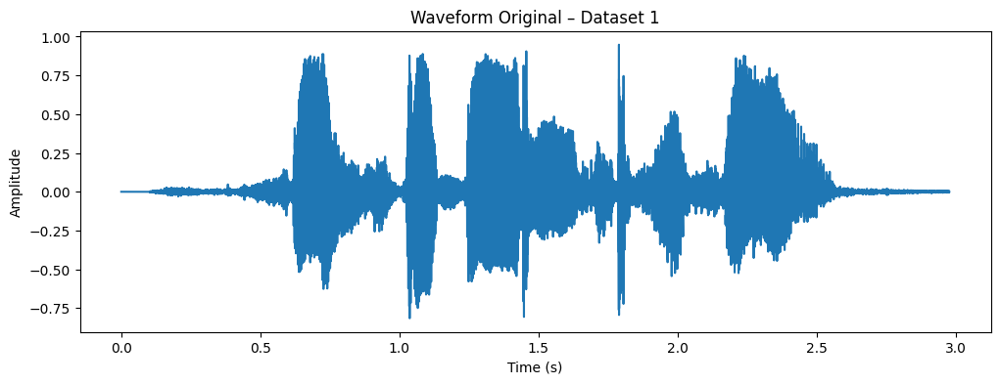

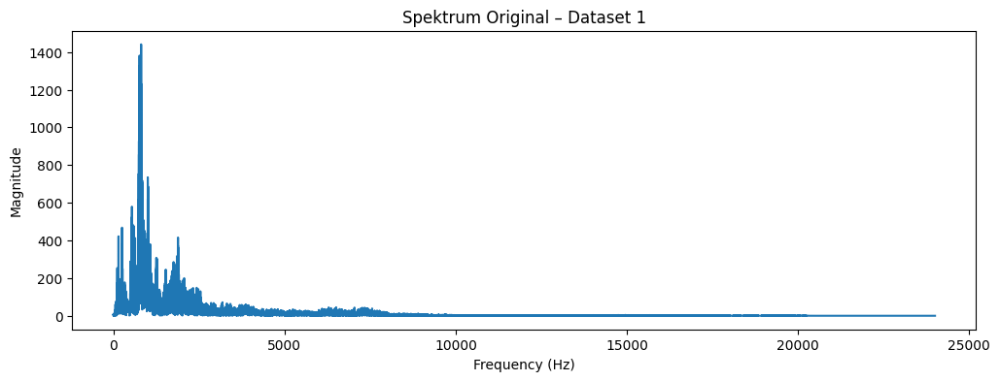

[ 0.          0.          0.         ...  0.00094604  0.00021362
 -0.00015259]


In [45]:
audio1, fs1 = load_audio("/content/drive/Shareddrives/Project PSD/1.wav")

show_waveform(audio1, fs1, "Waveform Original – Dataset 1")
show_spectrum(audio1, fs1, "Spektrum Original – Dataset 1")
Audio(audio1, rate=fs1)
print(audio1)

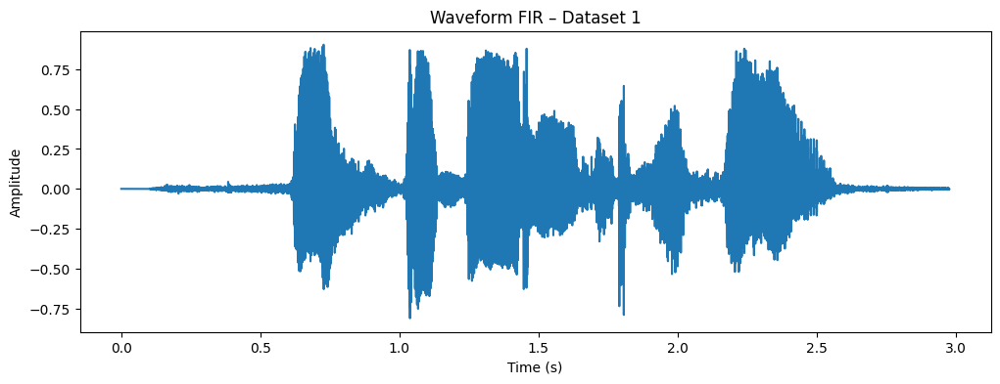

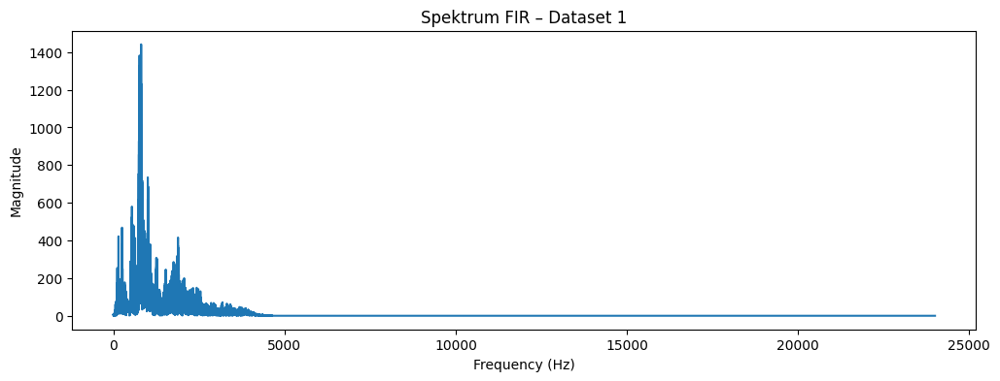

In [46]:
fir1 = apply_fir(audio1, cutoff=4000, fs=fs1)

show_waveform(fir1, fs1, "Waveform FIR – Dataset 1")
show_spectrum(fir1, fs1, "Spektrum FIR – Dataset 1")
write("fir_dataset1.wav", fs1, fir1)
Audio(fir1, rate=fs1)

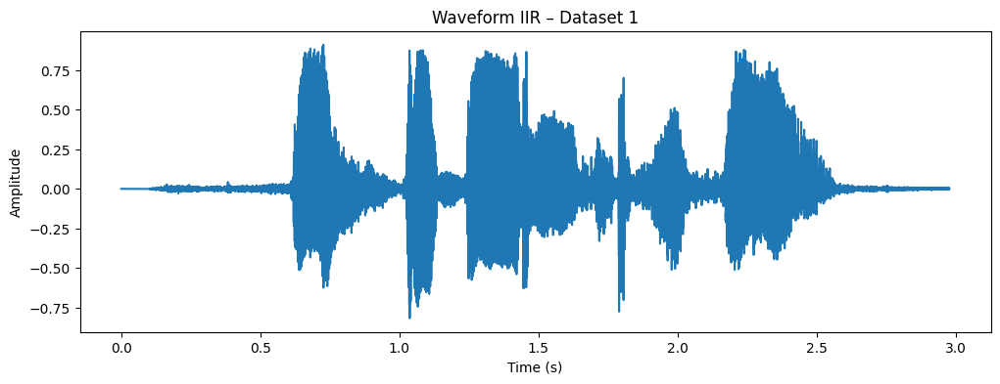

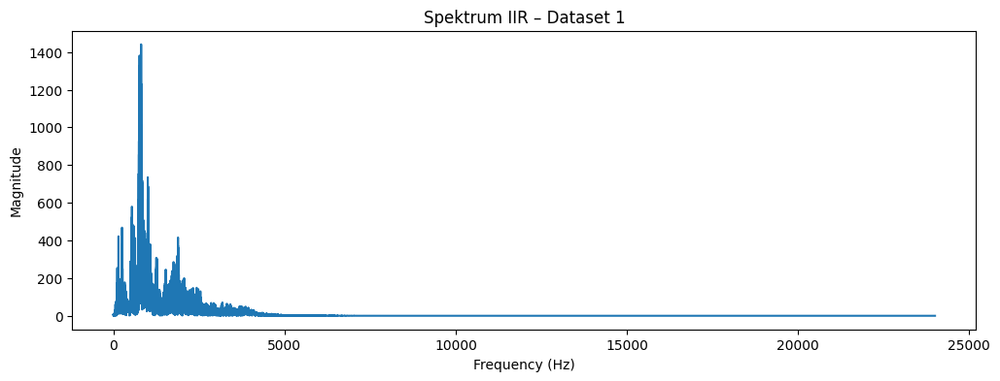

In [47]:
iir1 = apply_iir(audio1, cutoff=4000, fs=fs1)

show_waveform(iir1, fs1, "Waveform IIR – Dataset 1")
show_spectrum(iir1, fs1, "Spektrum IIR – Dataset 1")
write("iir_dataset1.wav", fs1, iir1)
Audio(iir1, rate=fs1)


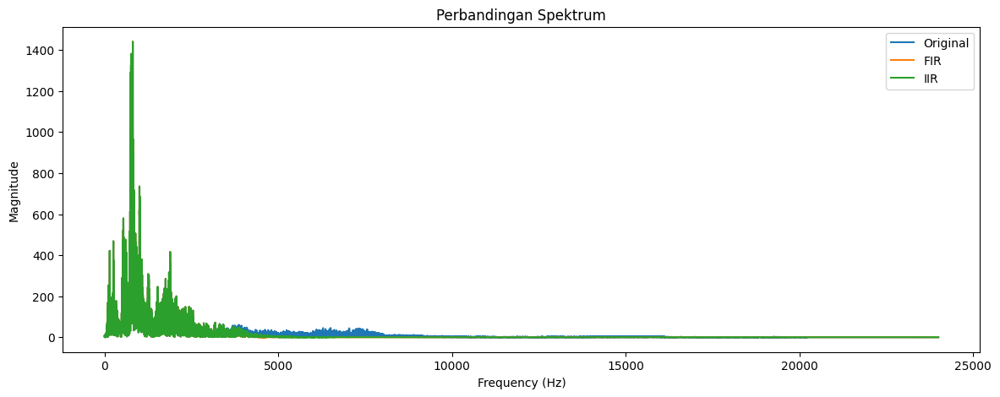

In [48]:
compare_spectrum(audio1, fir1, iir1, fs1)

In [49]:
snr_fir_1 = compute_snr(audio1, fir1)
snr_iir_1 = compute_snr(audio1, iir1)

mse_fir_1 = compute_mse(audio1, fir1)
mse_iir_1 = compute_mse(audio1, iir1)

final_conclusion(snr_fir_1, snr_iir_1, mse_fir_1, mse_iir_1)

HASIL ANALISIS
SNR FIR : -1.2996
SNR IIR : -0.9224
MSE FIR : 0.0331
MSE IIR : 0.0304

>> Berdasarkan SNR:  IIR
>> Berdasarkan MSE:  IIR

KESIMPULAN: Filter IIR lebih baik untuk dataset ini.


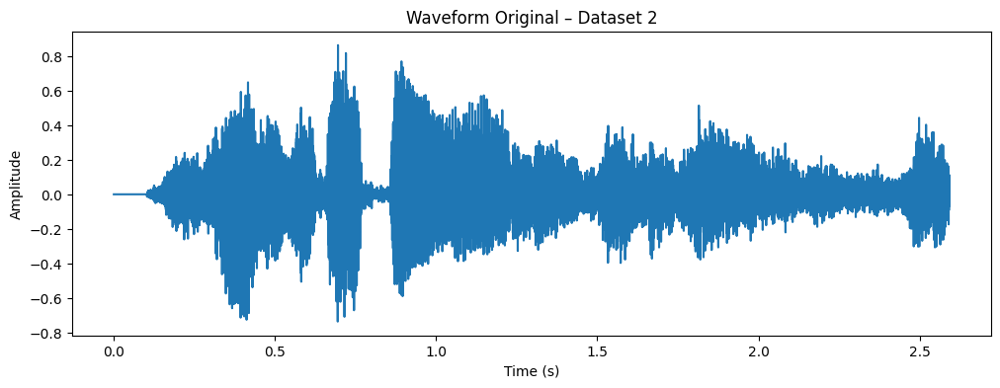

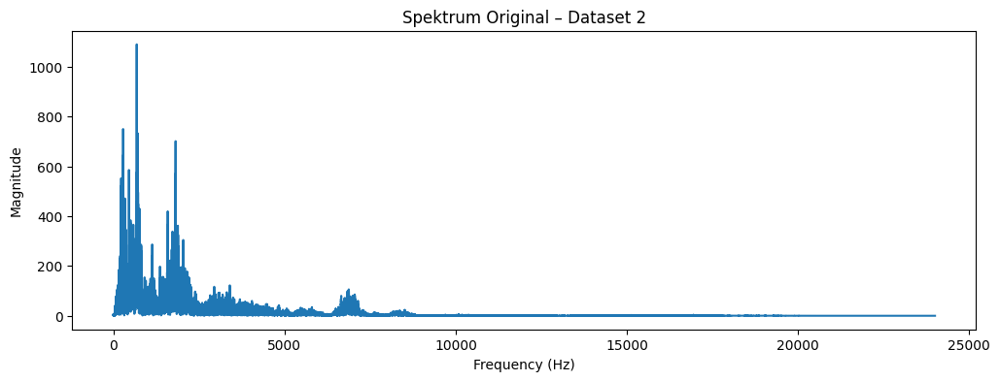

In [50]:
audio2, fs2 = load_audio("/content/drive/Shareddrives/Project PSD/2.wav")

show_waveform(audio2, fs2, "Waveform Original – Dataset 2")
show_spectrum(audio2, fs2, "Spektrum Original – Dataset 2")
Audio(audio2, rate=fs2)

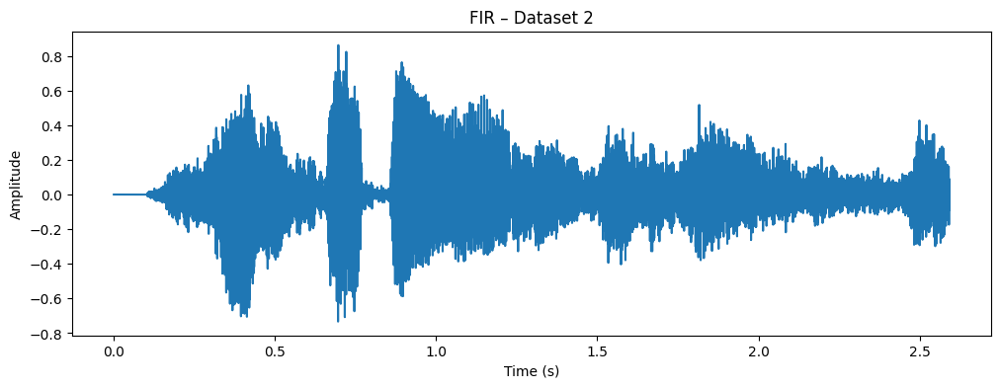

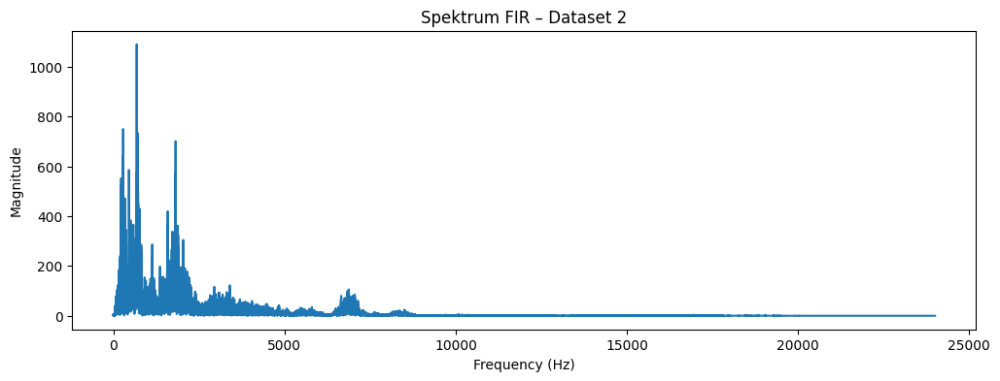

In [51]:
fir2 = apply_fir(audio2, cutoff=4000, fs=fs2)
show_waveform(fir2, fs2, "FIR – Dataset 2")
show_spectrum(audio2, fs2, "Spektrum FIR – Dataset 2")
write("fir_dataset2.wav", fs2, fir2)
Audio(fir2, rate=fs2)

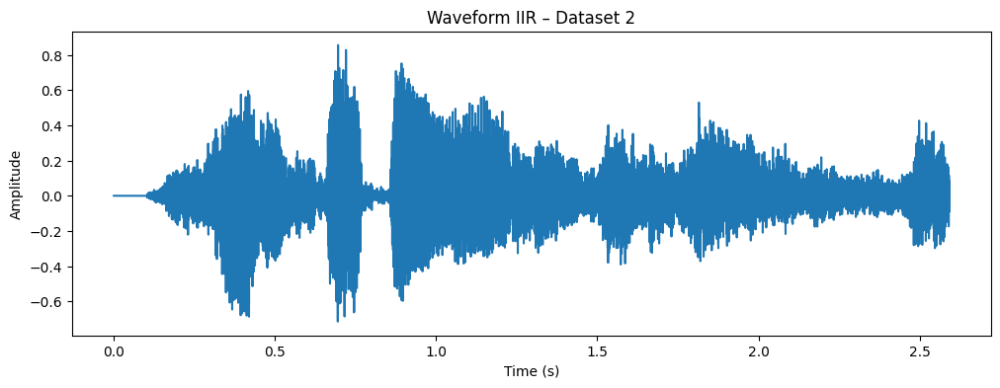

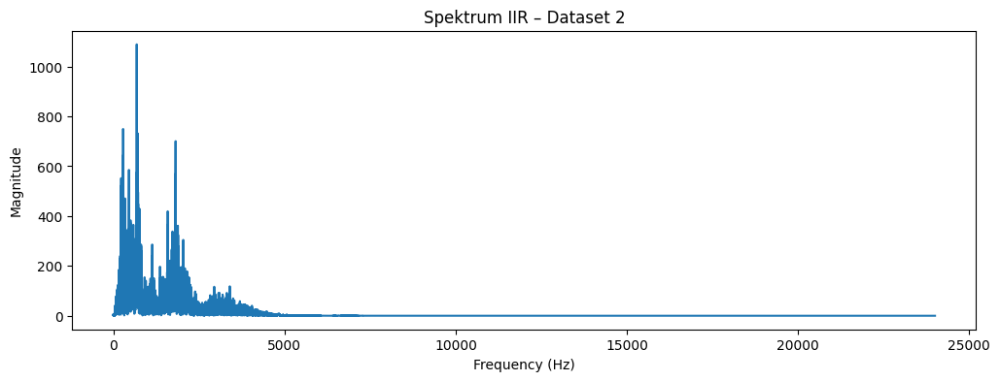

In [52]:
iir2 = apply_iir(audio2, cutoff=4000, fs=fs2)

show_waveform(iir2, fs2, "Waveform IIR – Dataset 2")
show_spectrum(iir2, fs2, "Spektrum IIR – Dataset 2")
write("iir_dataset1.wav", fs2, iir2)
Audio(iir2, rate=fs2)

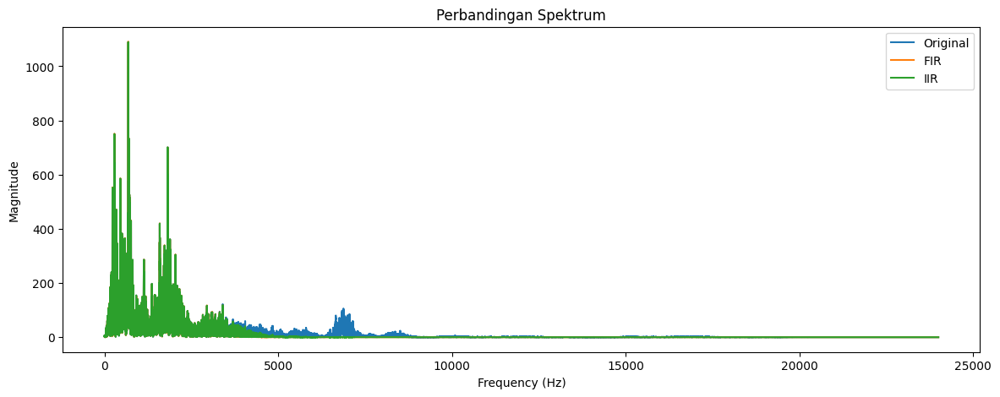

In [53]:
compare_spectrum(audio2, fir2, iir2, fs2)

In [54]:
snr_fir_2 = compute_snr(audio2, fir2)
snr_iir_2 = compute_snr(audio2, iir2)
mse_fir_2 = compute_mse(audio2, fir2)
mse_iir_2 = compute_mse(audio2, iir2)

final_conclusion(snr_fir_2, snr_iir_2, mse_fir_2, mse_iir_2)

HASIL ANALISIS
SNR FIR : -3.2983
SNR IIR : -1.4295
MSE FIR : 0.0349
MSE IIR : 0.0227

>> Berdasarkan SNR:  IIR
>> Berdasarkan MSE:  IIR

KESIMPULAN: Filter IIR lebih baik untuk dataset ini.


Menggunakan Highpass

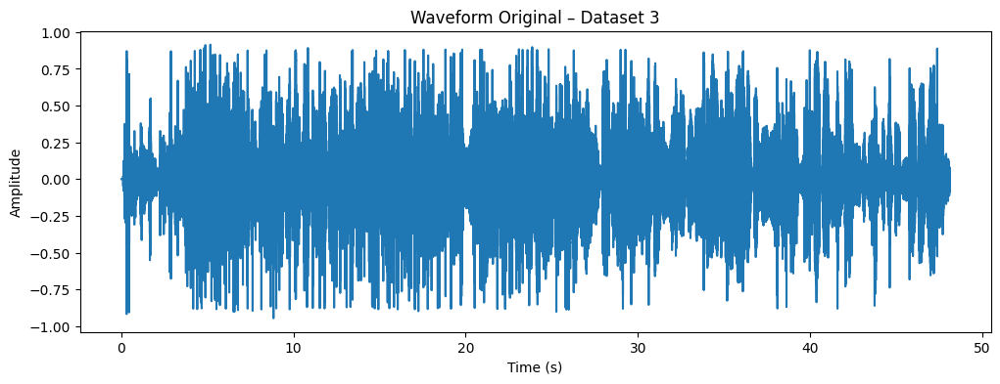

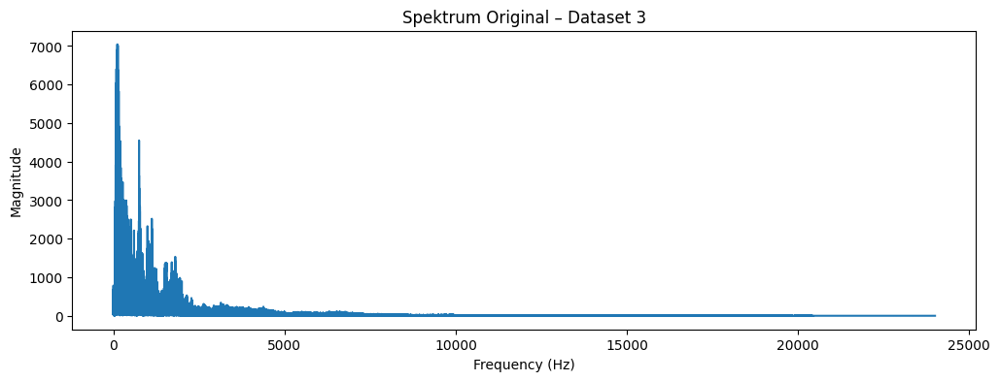

In [55]:
audio3, fs3 = load_audio("/content/drive/Shareddrives/Project PSD/Perekaman standar 4.wav")

show_waveform(audio3, fs3, "Waveform Original – Dataset 3")
show_spectrum(audio3, fs3, "Spektrum Original – Dataset 3")
Audio(audio3, rate=fs3)

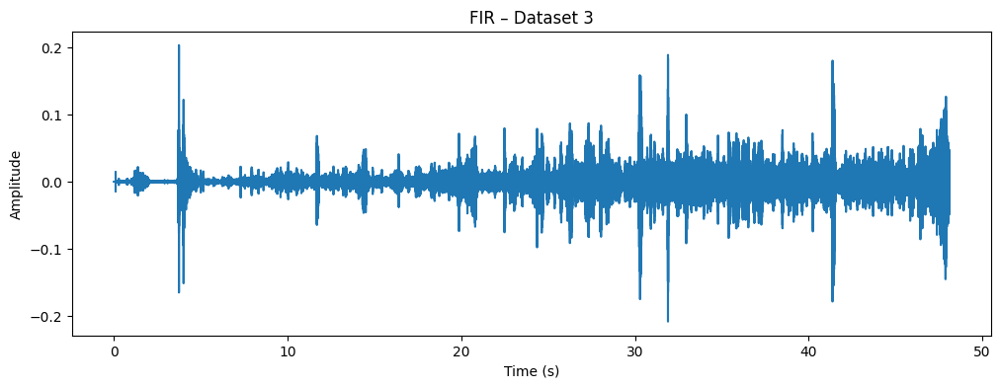

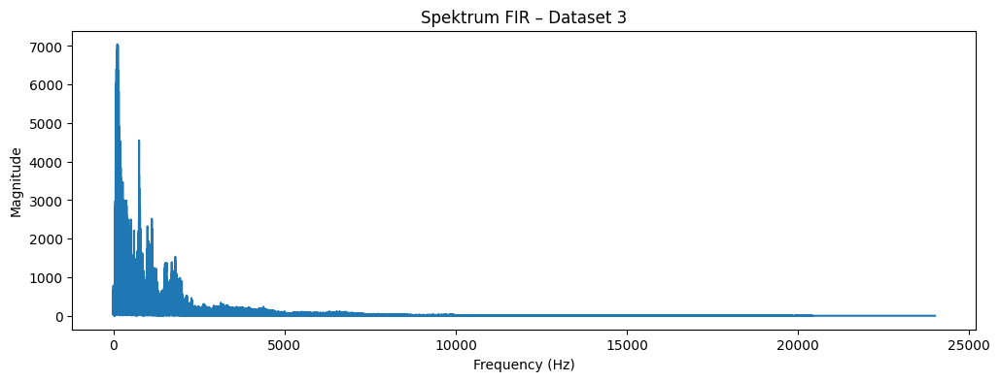

In [56]:
fir3 = apply_fir_highpass(audio3, cutoff=4000, fs=fs3)
show_waveform(fir3, fs3, "FIR – Dataset 3")
show_spectrum(audio3, fs3, "Spektrum FIR – Dataset 3")
write("fir_dataset3.wav", fs3, fir3)
Audio(fir3, rate=fs3)

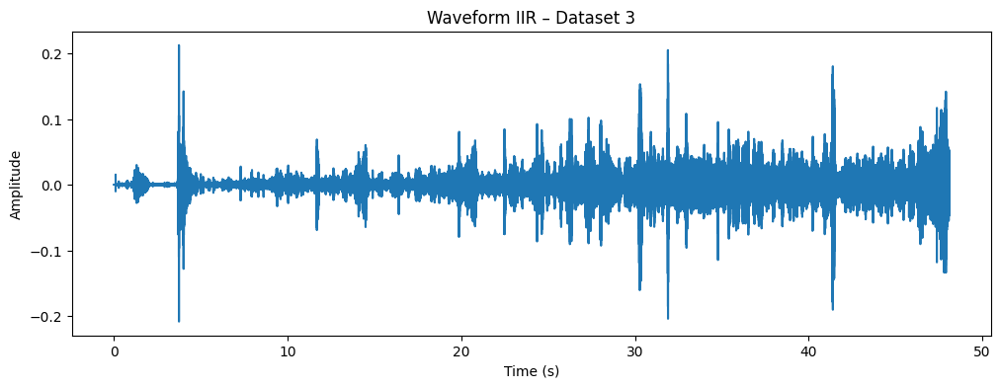

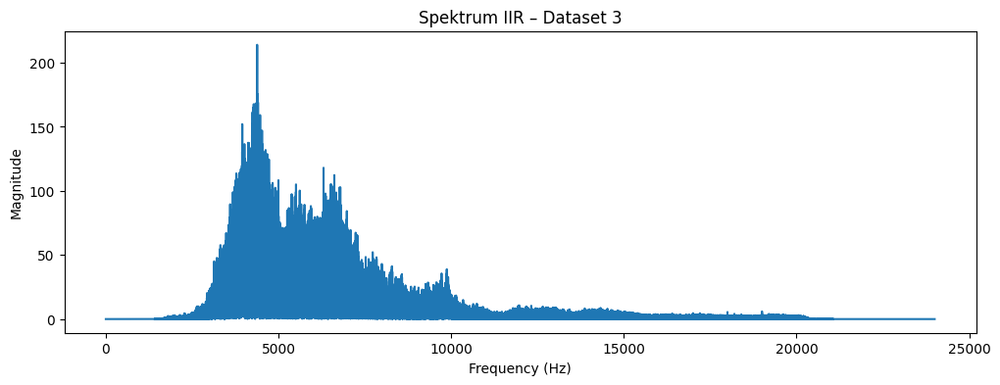

In [57]:
iir3 = apply_iir_highpass(audio3, cutoff=4000, fs=fs3)

show_waveform(iir3, fs3, "Waveform IIR – Dataset 3")
show_spectrum(iir3, fs3, "Spektrum IIR – Dataset 3")
write("iir_dataset3.wav", fs3, iir3)
Audio(iir3, rate=fs3)

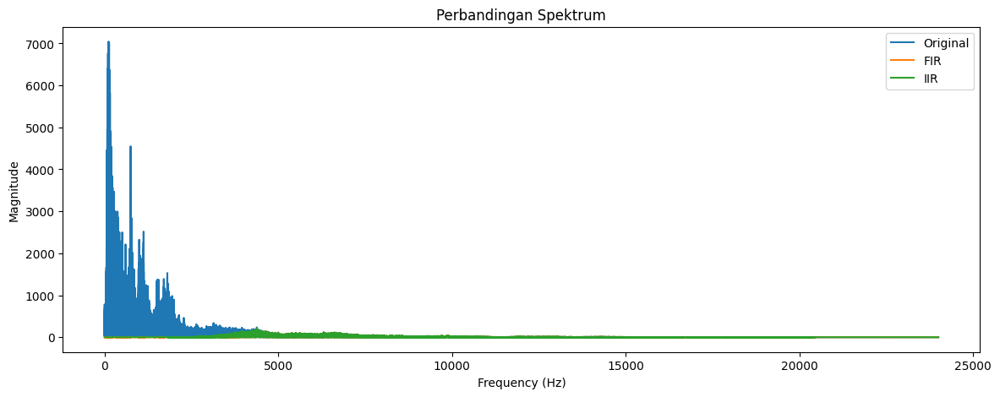

In [58]:
compare_spectrum(audio3, fir3, iir3, fs3)

In [59]:
snr_fir_3 = compute_snr(audio3, fir3)
snr_iir_3 = compute_snr(audio3, iir3)
mse_fir_3 = compute_mse(audio3, fir3)
mse_iir_3 = compute_mse(audio3, iir3)

final_conclusion(snr_fir_3, snr_iir_3, mse_fir_3, mse_iir_3)

HASIL ANALISIS
SNR FIR : -0.0139
SNR IIR : -0.0150
MSE FIR : 0.0264
MSE IIR : 0.0264

>> Berdasarkan SNR:  FIR
>> Berdasarkan MSE:  FIR

KESIMPULAN: Filter FIR lebih baik untuk dataset ini.
